# Convolutional Autoencoder as a Classifier for Liver Cancer Dataset


### Check ofr natural images

In [1]:
import os
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]="0" #model will be trained on GPU 0

## Loading in the data

In [2]:
import keras
import math
from matplotlib import pyplot as plt
import numpy as np
import gzip
%matplotlib inline
from keras.models import Model
from keras.optimizers import RMSprop
from keras.layers import Input,Dense,Flatten,Dropout,merge,Reshape,Conv2D,MaxPooling2D,UpSampling2D,Conv2DTranspose
from keras.layers.normalization import BatchNormalization
from keras.models import Model,Sequential
from keras.callbacks import ModelCheckpoint
from keras.optimizers import Adadelta, RMSprop,SGD,Adam
from keras import regularizers
from keras import backend as K
from keras.utils import to_categorical
from keras.layers import Input, Dense, Conv2D, MaxPooling2D, UpSampling2D, BatchNormalization, Activation
from keras.models import Model
from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras.optimizers import Adam
from keras.callbacks import LearningRateScheduler
import os
from keras.preprocessing import image as image_utils
from PIL import Image
from PIL import ImageFilter
import matplotlib.pyplot as plt
import numpy as np
#import cPickle
import pickle

Using TensorFlow backend.
/usr/local/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)
/usr/local/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)


### Data exploration

In [3]:
inp_dir = '../reconstr_myTestCases/'
img_list = os.listdir(inp_dir)
target_size = (256, 256)

img = 'cat1.jpeg'
all_images = []
all_labels = []
img_list = [img]
idx = 0

for img in img_list:
        fname = inp_dir + '/'+ img
        image = image_utils.load_img(fname).resize(target_size,Image.ANTIALIAS)
        image = np.array(image.getdata()).reshape(target_size[0], target_size[1], 3)
        image = image.astype('float32')/255
        all_images.append(image)
        all_labels.append(idx)

"""
fname = inp_dir + '/'+ img
image = image_utils.load_img(fname).resize(target_size,Image.ANTIALIAS)
image = np.array(image.getdata()).reshape(target_size[0], target_size[1], 3)
image = image.astype('float32')/255
"""

all_images = np.array(all_images)
all_labels = np.array(all_labels)

print(all_images.shape)
print(all_labels.shape)

print(image)

(1, 256, 256, 3)
(1,)
[[[0.26666668 0.00784314 0.01568628]
  [0.2784314  0.00784314 0.01960784]
  [0.2784314  0.00784314 0.01960784]
  ...
  [0.27450982 0.         0.02745098]
  [0.3019608  0.00392157 0.05098039]
  [0.30588236 0.00784314 0.05882353]]

 [[0.26666668 0.00784314 0.01568628]
  [0.2784314  0.00784314 0.01960784]
  [0.2784314  0.00784314 0.01960784]
  ...
  [0.28235295 0.         0.03529412]
  [0.29803923 0.00784314 0.05490196]
  [0.30588236 0.01176471 0.0627451 ]]

 [[0.26666668 0.00784314 0.01568628]
  [0.2784314  0.00784314 0.01960784]
  [0.2784314  0.00784314 0.01960784]
  ...
  [0.29411766 0.00392157 0.05882353]
  [0.29411766 0.00784314 0.05882353]
  [0.3019608  0.01568628 0.06666667]]

 ...

 [[0.34117648 0.         0.02745098]
  [0.33333334 0.         0.02745098]
  [0.32941177 0.         0.02745098]
  ...
  [0.5058824  0.09019608 0.14117648]
  [0.49019608 0.08235294 0.13725491]
  [0.4745098  0.08235294 0.12941177]]

 [[0.30980393 0.00392157 0.03921569]
  [0.30588236 0

In [4]:
train_data = np.load('datasets_train/full_x.npy')
train_labels = np.load('datasets_train/full_y.npy')
val_data = np.load('datasets_val/full_x.npy')
val_labels = np.load('datasets_val/full_y.npy')

test_data = all_images #np.load('../reconstr_myTestCases/datasets_caltech_cakra/full_x.npy')
test_labels = all_labels #np.load('../reconstr_myTestCases/datasets_caltech_cakra/full_y.npy')

In [5]:
# Shapes of training set
print("Training set (images) shape: {shape}".format(shape=train_data.shape))

#print("Validation dataset (images) shape: {shape}".format(shape=val_data.shape))

# Shapes of test set
print("Test set (images) shape: {shape}".format(shape=test_data.shape))
print(test_labels)
#print(test_data)
train_data.dtype, test_data.dtype

Training set (images) shape: (1000, 256, 256, 3)
Test set (images) shape: (1, 256, 256, 3)
[0]


(dtype('float32'), dtype('float32'))

In [6]:
# Create dictionary of target classes
label_dict = {
 0: 'non-viable',
 1: 'viable',
}

Text(0.5,1,'(Label: non-viable)')

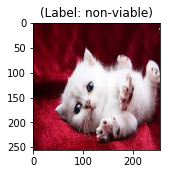

In [7]:
plt.figure(figsize=[5,5])
"""
# Display the first image in training data
plt.subplot(121)
curr_img = np.reshape(train_data[300], (256,256,3))
curr_lbl = train_labels[300]
plt.imshow(curr_img) #, cmap='gray')
plt.title("(Label: " + str(label_dict[curr_lbl]) + ")")

"""

# Display the first image in testing data
plt.subplot(122)
curr_img = np.reshape(test_data[0], (256, 256, 3))
curr_lbl = test_labels[0]
plt.imshow(curr_img, cmap='gray')
plt.title("(Label: " + str(label_dict[curr_lbl]) + ")")

In [12]:
#np.max(train_data), np.max(test_data)

In [8]:
train_X = train_data
valid_X = val_data
train_ground = train_labels
valid_ground = val_labels

## The Convolutional Autoencoder!

In [9]:
batch_size = 64
epochs = 100 #200
inChannel = 3
x, y = 256, 256
input_img = Input(shape = (x, y, inChannel))
num_classes = 2 

W0726 14:39:33.351692 139924546066176 deprecation_wrapper.py:119] From /home/mousumi/ENV_1/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0726 14:39:33.389005 139924546066176 deprecation_wrapper.py:119] From /home/mousumi/ENV_1/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.



In [19]:
def encoder(input_img):
    #encoder
    #input = 28 x 28 x 1 (wide and thin)
    conv1 = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img) #28 x 28 x 32
    conv1 = BatchNormalization()(conv1)
    conv1 = Conv2D(32, (3, 3), activation='relu', padding='same')(conv1)
    conv1 = BatchNormalization()(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1) #14 x 14 x 32
    conv2 = Conv2D(64, (3, 3), activation='relu', padding='same')(pool1) #14 x 14 x 64
    conv2 = BatchNormalization()(conv2)
    conv2 = Conv2D(64, (3, 3), activation='relu', padding='same')(conv2)
    conv2 = BatchNormalization()(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2) #7 x 7 x 64
    conv3 = Conv2D(128, (3, 3), activation='relu', padding='same')(pool2) #7 x 7 x 128 (small and thick)
    conv3 = BatchNormalization()(conv3)
    conv3 = Conv2D(128, (3, 3), activation='relu', padding='same')(conv3)
    conv3 = BatchNormalization()(conv3)
    conv4 = Conv2D(256, (3, 3), activation='relu', padding='same')(conv3) #7 x 7 x 256 (small and thick)
    conv4 = BatchNormalization()(conv4)
    conv4 = Conv2D(256, (3, 3), activation='relu', padding='same')(conv4)
    conv4 = BatchNormalization()(conv4)
    return conv4

def decoder(conv4):    
    #decoder
    conv5 = Conv2D(128, (3, 3), activation='relu', padding='same')(conv4) #7 x 7 x 128
    conv5 = BatchNormalization()(conv5)
    conv5 = Conv2D(128, (3, 3), activation='relu', padding='same')(conv5)
    conv5 = BatchNormalization()(conv5)
    conv6 = Conv2D(64, (3, 3), activation='relu', padding='same')(conv5) #7 x 7 x 64
    conv6 = BatchNormalization()(conv6)
    conv6 = Conv2D(64, (3, 3), activation='relu', padding='same')(conv6)
    conv6 = BatchNormalization()(conv6)
    up1 = UpSampling2D((2,2))(conv6) #14 x 14 x 64
    conv7 = Conv2D(32, (3, 3), activation='relu', padding='same')(up1) # 14 x 14 x 32
    conv7 = BatchNormalization()(conv7)
    conv7 = Conv2D(32, (3, 3), activation='relu', padding='same')(conv7)
    conv7 = BatchNormalization()(conv7)
    up2 = UpSampling2D((2,2))(conv7) # 28 x 28 x 32
    decoded = Conv2D(3, (3, 3), activation='sigmoid', padding='same')(up2) # 28 x 28 x 1
    return decoded

In [26]:
# encoder_model = Model(input_img, encoder(input_img)).summary(line_length=100)

In [11]:
autoencoder = Model(input_img, decoder(encoder(input_img)))
autoencoder.compile(loss='mean_squared_error', optimizer = RMSprop())

W0726 14:39:39.602735 139924546066176 deprecation_wrapper.py:119] From /home/mousumi/ENV_1/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:4138: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.

W0726 14:39:39.637254 139924546066176 deprecation_wrapper.py:119] From /home/mousumi/ENV_1/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:174: The name tf.get_default_session is deprecated. Please use tf.compat.v1.get_default_session instead.

W0726 14:39:39.638391 139924546066176 deprecation_wrapper.py:119] From /home/mousumi/ENV_1/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:181: The name tf.ConfigProto is deprecated. Please use tf.compat.v1.ConfigProto instead.

W0726 14:39:43.071714 139924546066176 deprecation_wrapper.py:119] From /home/mousumi/ENV_1/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:1834: The name tf.nn.fused_batch_norm is deprecated. Please use tf.compat.v1.nn.fused_batch_norm 

In [12]:
autoencoder.summary()
autoencoder.layers
len(autoencoder.layers)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 256, 256, 3)       0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 256, 256, 32)      896       
_________________________________________________________________
batch_normalization_1 (Batch (None, 256, 256, 32)      128       
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 256, 256, 32)      9248      
_________________________________________________________________
batch_normalization_2 (Batch (None, 256, 256, 32)      128       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 128, 128, 64)      18496     
__________

34

## Train the model

In [47]:
autoencoder_train = autoencoder.fit(train_X,train_X, batch_size=batch_size,epochs=epochs,verbose=1,validation_data=(valid_X, valid_X))

Train on 1000 samples, validate on 200 samples
Epoch 1/100
1000/1000 [==============================] - 17s 17ms/step - loss: 0.0039 - val_loss: 0.0045
Epoch 2/100
1000/1000 [==============================] - 12s 12ms/step - loss: 0.0035 - val_loss: 0.0038
Epoch 3/100
1000/1000 [==============================] - 12s 12ms/step - loss: 0.0034 - val_loss: 0.0043
Epoch 4/100
1000/1000 [==============================] - 12s 12ms/step - loss: 0.0034 - val_loss: 0.0052
Epoch 5/100
1000/1000 [==============================] - 12s 12ms/step - loss: 0.0034 - val_loss: 0.0039
Epoch 6/100
1000/1000 [==============================] - 12s 12ms/step - loss: 0.0034 - val_loss: 0.0040
Epoch 7/100
1000/1000 [==============================] - 12s 12ms/step - loss: 0.0033 - val_loss: 0.0040
Epoch 8/100
1000/1000 [==============================] - 12s 12ms/step - loss: 0.0033 - val_loss: 0.0051
Epoch 9/100
1000/1000 [==============================] - 12s 12ms/step - loss: 0.0034 - val_loss: 0.0047
Epoch 10

Epoch 78/100
1000/1000 [==============================] - 12s 12ms/step - loss: 0.0028 - val_loss: 0.0047
Epoch 79/100
1000/1000 [==============================] - 12s 12ms/step - loss: 0.0029 - val_loss: 0.0036
Epoch 80/100
1000/1000 [==============================] - 12s 12ms/step - loss: 0.0029 - val_loss: 0.0036
Epoch 81/100
1000/1000 [==============================] - 12s 12ms/step - loss: 0.0028 - val_loss: 0.0039
Epoch 82/100
1000/1000 [==============================] - 12s 12ms/step - loss: 0.0029 - val_loss: 0.0041
Epoch 83/100
1000/1000 [==============================] - 12s 12ms/step - loss: 0.0029 - val_loss: 0.0049
Epoch 84/100
1000/1000 [==============================] - 12s 12ms/step - loss: 0.0027 - val_loss: 0.0040
Epoch 85/100
1000/1000 [==============================] - 12s 12ms/step - loss: 0.0028 - val_loss: 0.0034
Epoch 86/100
1000/1000 [==============================] - 12s 12ms/step - loss: 0.0029 - val_loss: 0.0041
Epoch 87/100
1000/1000 [======================

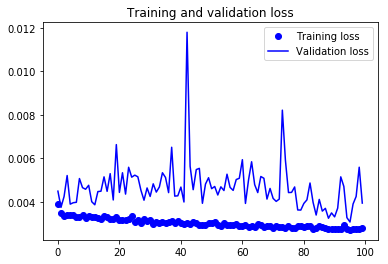

In [48]:
loss = autoencoder_train.history['loss']
val_loss = autoencoder_train.history['val_loss']
epochs = range(100)
plt.figure()
plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
plt.show()

### Save the Model

In [49]:
autoencoder.save_weights('autoencoder_100epoch.h5')

In [93]:
"""
layer_outputs = [layer.output for layer in autoencoder.layers]
activation_model = Model(inputs=autoencoder.input, outputs=layer_outputs)
activations = activation_model.predict(test_data[0])
 
def display_activation(activations, col_size, row_size, act_index): 
    activation = activations[act_index]
    activation_index=0
    fig, ax = plt.subplots(row_size, col_size, figsize=(row_size*2.5,col_size*1.5))
    for row in range(0,row_size):
        for col in range(0,col_size):
            ax[row][col].imshow(activation[0, :, :, activation_index], cmap='gray')
            activation_index += 1
"""




"\nlayer_outputs = [layer.output for layer in autoencoder.layers]\nactivation_model = Model(inputs=autoencoder.input, outputs=layer_outputs)\nactivations = activation_model.predict(test_data[0])\n \ndef display_activation(activations, col_size, row_size, act_index): \n    activation = activations[act_index]\n    activation_index=0\n    fig, ax = plt.subplots(row_size, col_size, figsize=(row_size*2.5,col_size*1.5))\n    for row in range(0,row_size):\n        for col in range(0,col_size):\n            ax[row][col].imshow(activation[0, :, :, activation_index], cmap='gray')\n            activation_index += 1\n"

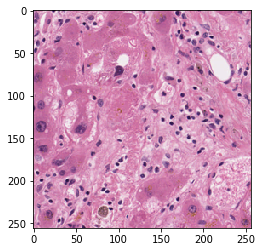

In [15]:
img2 = train_X[12]
plt.figure()
plt.imshow(img2)

['input_1', 'conv2d_1', 'batch_normalization_1', 'conv2d_2', 'batch_normalization_2', 'max_pooling2d_1', 'conv2d_3', 'batch_normalization_3', 'conv2d_4', 'batch_normalization_4', 'max_pooling2d_2', 'conv2d_5', 'batch_normalization_5', 'conv2d_6', 'batch_normalization_6', 'conv2d_7', 'batch_normalization_7', 'conv2d_8', 'batch_normalization_8', 'conv2d_9', 'batch_normalization_9', 'conv2d_10', 'batch_normalization_10', 'conv2d_11', 'batch_normalization_11', 'conv2d_12', 'batch_normalization_12', 'up_sampling2d_1', 'conv2d_13', 'batch_normalization_13', 'conv2d_14', 'batch_normalization_14', 'up_sampling2d_2', 'conv2d_15']


/home/mousumi/ENV_1/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


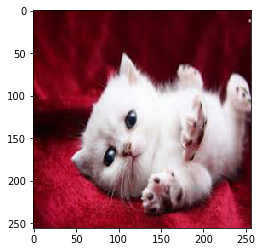

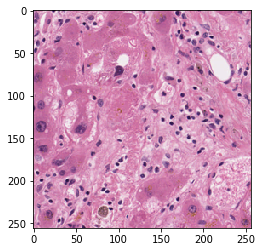

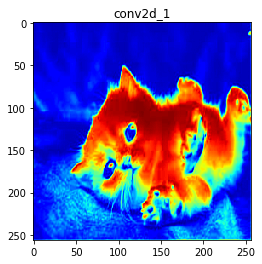

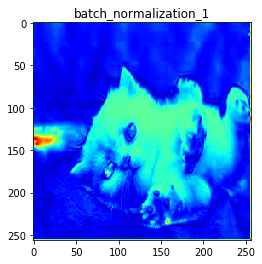

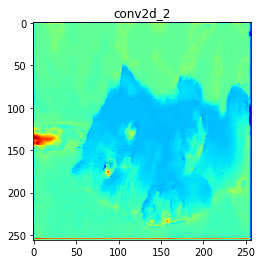

...

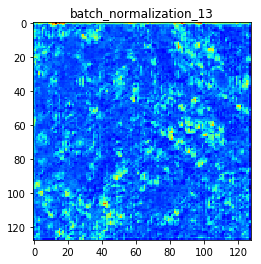

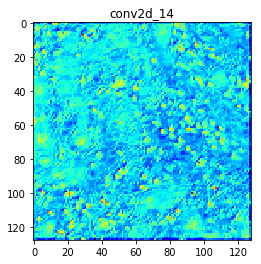

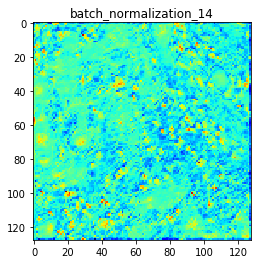

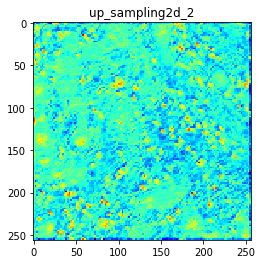

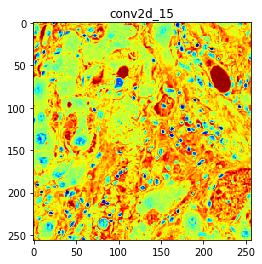

In [16]:
#function to get activations of a layer
from keras import backend as K
def get_activations(model, layer, X_batch):
    get_activations = K.function([model.layers[0].input, K.learning_phase()], [model.layers[layer].output,])
    activations = get_activations([X_batch,0])
    return activations

#Get activations using layername
def get_activation_from_layer(model,layer_name,layers,layers_dim,img):
    #print(get_activations(model, layers[layer_name], img.reshape(1,256,256,3)))
    #layers_dim[layer_name][0]
    #layers_dim[layer_name][1]
    #layers_dim[layer_name][2]
    acti = get_activations(model, layers[layer_name], img.reshape(1,256,256,3))[0].reshape(layers_dim[layer_name][0],layers_dim[layer_name][1],layers_dim[layer_name][2])
    return np.sum(acti,axis=2)  

#Map layer name with layer index
layers = dict()
index = None
for idx, layer in enumerate(autoencoder.layers):
      layers[layer.name] = idx

#Map layer name with its dimension
layers_dim = dict()

for layer in autoencoder.layers:
      layers_dim[layer.name] = layer.get_output_at(0).get_shape().as_list()[1:]

#print(layers_dim)
#print(layers)

layer_names =[]
for layer in autoencoder.layers:
    layer_names.append(layer.name)

print(layer_names)

#img1 = utils.load_img("image.png", target_size=(256, 256))
img1 = test_data[0]
plt.figure()
plt.imshow(img1)

img2 = train_X[12]
plt.figure()
plt.imshow(img2)

for i in layer_names[1:]:
    plt.figure()
    layer_name = i
    
    plt.imshow(get_activation_from_layer(autoencoder,layer_name,layers,layers_dim, img1), cmap="jet")
    plt.title(layer_name)
    
    
    
for i in layer_names[1:]:
    plt.figure()
    layer_name = i
    
    plt.imshow(get_activation_from_layer(autoencoder,layer_name,layers,layers_dim, img2), cmap="jet")
    plt.title(layer_name)
    

## Show the reconstruction result from autoencoder

In [14]:
print(encoder(input_img))

Tensor("batch_normalization_22/cond/Merge:0", shape=(?, 64, 64, 256), dtype=float32)


In [13]:
autoencoder.load_weights('../autoencoder.h5')

In [17]:
score = autoencoder.evaluate(test_data, test_data, verbose=1)
print(score)

1/1 [==============================] - 1s 585ms/step
0.0020944508723914623


In [26]:
liverImage_test = autoencoder.predict(test_data)
#liverImage_val = autoencoder.predict(valid_X)

In [30]:
print("Cifar10_test: {0}\nCifar10_val: {1}".format(np.average(liverImage_test), np.average(liverImage_test)))

Cifar10_test: 0.4650341272354126
Cifar10_val: 0.4650341272354126


In [17]:
# definition to show original image and reconstructed image
def showOrigDec(orig, dec, num=1):
    import matplotlib.pyplot as plt
    n = num
    plt.figure(figsize=(20, 4))

    for i in range(n):
        # display original
        ax = plt.subplot(2, n, i+1)
        plt.imshow(orig[i].reshape(256, 256, 3))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # display reconstruction
        ax = plt.subplot(2, n, i +1 + n)
        plt.imshow(dec[i].reshape(256, 256, 3))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
    plt.show()

In [18]:
showOrigDec(test_data, liverImage_test)

NameError: name 'liverImage_test' is not defined

# Segmenting the liver cancer images

In [17]:
# Change the labels from categorical to one-hot encoding
train_Y_one_hot = to_categorical(train_labels)
val_Y_one_hot = to_categorical(val_labels)
test_Y_one_hot = to_categorical(test_labels)
#test_Y_one_hot = test_Y_one_hot1[:100]

# Display the change for category label using one-hot encoding
print('Original label:', test_labels[150])
print('After conversion to one-hot:', test_Y_one_hot[150])

Original label: 1
After conversion to one-hot: [0. 1.]


In [18]:
train_label = train_Y_one_hot
valid_label = val_Y_one_hot

#train_label = train_labels
#valid_label = val_labels
train_X.shape,valid_X.shape,train_label.shape,valid_label.shape

((1000, 256, 256, 3), (200, 256, 256, 3), (1000, 2), (200, 2))

In [19]:
def encoder(input_img):
    #encoder
    #input = 28 x 28 x 1 (wide and thin)
    conv1 = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img) 
    conv1 = BatchNormalization()(conv1)
    conv1 = Conv2D(32, (3, 3), activation='relu', padding='same')(conv1)
    conv1 = BatchNormalization()(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1) 
    conv2 = Conv2D(64, (3, 3), activation='relu', padding='same')(pool1) 
    conv2 = BatchNormalization()(conv2)
    conv2 = Conv2D(64, (3, 3), activation='relu', padding='same')(conv2)
    conv2 = BatchNormalization()(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2) 
    conv3 = Conv2D(128, (3, 3), activation='relu', padding='same')(pool2) 
    conv3 = BatchNormalization()(conv3)
    conv3 = Conv2D(128, (3, 3), activation='relu', padding='same')(conv3)
    conv3 = BatchNormalization()(conv3)
    #pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)
    conv4 = Conv2D(256, (3, 3), activation='relu', padding='same')(conv3)  #(small and thick)
    conv4 = BatchNormalization()(conv4)
    conv4 = Conv2D(256, (3, 3), activation='relu', padding='same')(conv4)
    conv4 = BatchNormalization()(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)
    conv5 = Conv2D(512, (3, 3), activation='relu', padding='same')(pool4) # (small and thick)
    conv5 = BatchNormalization()(conv5)
    conv5 = Conv2D(512, (3, 3), activation='relu', padding='same')(conv5)
    conv5 = BatchNormalization()(conv5)
    pool5 = MaxPooling2D(pool_size=(2, 2))(conv5)
    conv6 = Conv2D(512, (3, 3), activation='relu', padding='same')(pool5) # (small and thick)
    conv6 = BatchNormalization()(conv6)
    conv6 = Conv2D(512, (3, 3), activation='relu', padding='same')(conv6)
    conv6 = BatchNormalization()(conv6)
    pool6 = MaxPooling2D(pool_size=(2, 2))(conv6)
    
    return pool6

In [20]:
def fc(enco):
    flat = Flatten()(enco)
    den = Dense(4096, activation='relu')(flat)
    den = Dropout(0.5)(den)
    den = Dense(4096, activation='relu')(den)
    den = Dropout(0.5)(den)
    den = Dense(256, activation='relu')(den)
    den = Dropout(0.5)(den)
    out = Dense(num_classes, activation='softmax')(den)
    #out = Dense(1, activation='sigmoid')(den) 
    return out

In [21]:
encode = encoder(input_img)
full_model = Model(input_img,fc(encode))
full_model.summary()
full_model.layers
len(full_model.layers)

W0718 19:52:57.320031 140610914539264 deprecation.py:506] From /home/mousumi/ENV_1/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:3445: calling dropout (from tensorflow.python.ops.nn_ops) with keep_prob is deprecated and will be removed in a future version.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 256, 256, 3)       0         
_________________________________________________________________
conv2d_16 (Conv2D)           (None, 256, 256, 32)      896       
_________________________________________________________________
batch_normalization_15 (Batc (None, 256, 256, 32)      128       
_________________________________________________________________
conv2d_17 (Conv2D)           (None, 256, 256, 32)      9248      
_________________________________________________________________
batch_normalization_16 (Batc (None, 256, 256, 32)      128       
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 128, 128, 32)      0         
_________________________________________________________________
conv2d_18 (Conv2D)           (None, 128, 128, 64)      18496     
__________

38

In [22]:
for l1,l2 in zip(full_model.layers[:19],autoencoder.layers[0:19]):
    l1.set_weights(l2.get_weights())

In [26]:
#full_model.get_weights()[0][1]

In [27]:
#autoencoder.get_weights()[0][1]

In [28]:
for layer in full_model.layers[0:19]:
    layer.trainable = False

In [24]:
# learning rate schedule
def step_decay(epoch):
    initial_lrate = 0.0001
    drop = 0.5
    epochs_drop = 10.0
    lrate = initial_lrate * math.pow(drop, math.floor((1+epoch)/epochs_drop))
    return lrate
 

In [30]:
full_model.compile(loss=keras.losses.categorical_crossentropy, optimizer=keras.optimizers.Adam(), metrics=['accuracy'])

In [28]:
# learning schedule callback
lrate = LearningRateScheduler(step_decay)
callbacks_list = [lrate]

In [32]:
#full_model.summary()
#full_model.layers
#len(full_model.layers)

# Train the Model

In [33]:
def on_epoch_end(epoch, logs=None):
    print(K.eval(full_model.optimizer.lr))
    
on_epoch_end(epoch=10, logs=None)
classify_train = full_model.fit(train_X, train_label, batch_size=64,epochs=100,verbose=1,callbacks=callbacks_list,validation_data=(valid_X, valid_label))

0.001
Train on 1000 samples, validate on 200 samples
Epoch 1/100
1000/1000 [==============================] - 22s 22ms/step - loss: 1.9651 - acc: 0.5390 - val_loss: 1.1789 - val_acc: 0.5800
Epoch 2/100
1000/1000 [==============================] - 6s 6ms/step - loss: 0.8952 - acc: 0.7120 - val_loss: 0.7983 - val_acc: 0.7000
Epoch 3/100
1000/1000 [==============================] - 6s 6ms/step - loss: 0.6894 - acc: 0.7530 - val_loss: 0.7354 - val_acc: 0.6900
Epoch 4/100
1000/1000 [==============================] - 6s 6ms/step - loss: 0.6008 - acc: 0.7970 - val_loss: 0.9011 - val_acc: 0.6850
Epoch 5/100
1000/1000 [==============================] - 6s 6ms/step - loss: 0.6333 - acc: 0.7870 - val_loss: 0.8533 - val_acc: 0.6900
Epoch 6/100
1000/1000 [==============================] - 6s 6ms/step - loss: 0.5833 - acc: 0.8010 - val_loss: 0.8395 - val_acc: 0.6750
Epoch 7/100
1000/1000 [==============================] - 6s 6ms/step - loss: 0.6345 - acc: 0.8120 - val_loss: 0.9370 - val_acc: 0.6850


Epoch 61/100
1000/1000 [==============================] - 6s 6ms/step - loss: 0.1549 - acc: 0.9790 - val_loss: 0.8817 - val_acc: 0.8000
Epoch 62/100
1000/1000 [==============================] - 6s 6ms/step - loss: 0.1180 - acc: 0.9790 - val_loss: 0.8613 - val_acc: 0.7850
Epoch 63/100
1000/1000 [==============================] - 6s 6ms/step - loss: 0.1290 - acc: 0.9750 - val_loss: 0.8527 - val_acc: 0.7950
Epoch 64/100
1000/1000 [==============================] - 6s 6ms/step - loss: 0.1163 - acc: 0.9810 - val_loss: 0.8631 - val_acc: 0.8000
Epoch 65/100
1000/1000 [==============================] - 6s 6ms/step - loss: 0.1329 - acc: 0.9750 - val_loss: 0.8623 - val_acc: 0.7950
Epoch 66/100
1000/1000 [==============================] - 6s 6ms/step - loss: 0.0963 - acc: 0.9780 - val_loss: 0.8632 - val_acc: 0.7900
Epoch 67/100
1000/1000 [==============================] - 6s 6ms/step - loss: 0.1570 - acc: 0.9770 - val_loss: 0.8625 - val_acc: 0.7900
Epoch 68/100
1000/1000 [========================

In [34]:
full_model.save_weights('autoencoder_classification_100epoch.h5')

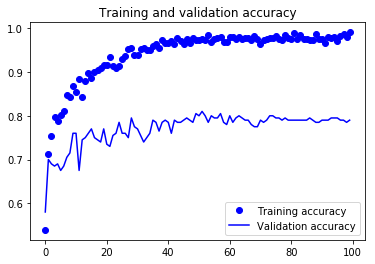

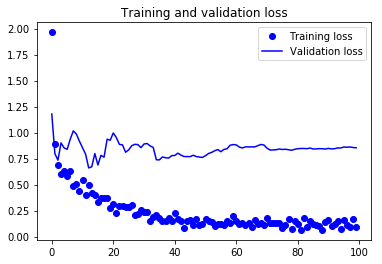

In [35]:
accuracy = classify_train.history['acc']
val_accuracy = classify_train.history['val_acc']
loss = classify_train.history['loss']
val_loss = classify_train.history['val_loss']
epochs = range(len(accuracy))
plt.plot(epochs, accuracy, 'bo', label='Training accuracy')
plt.plot(epochs, val_accuracy, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.legend()
plt.figure()
plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
plt.show()

## Model Evaluation on the Test Set

In [36]:
test_eval = full_model.evaluate(test_data, test_Y_one_hot, verbose=0)

In [37]:
print('Test loss:', test_eval[0])
print('Test accuracy:', test_eval[1])

Test loss: 0.5389111351966858
Test accuracy: 0.865


## Predict Labels

In [38]:
predicted_classes = full_model.predict(test_data)

In [39]:
predicted_classes = np.argmax(np.round(predicted_classes),axis=1)

Found 173 correct labels


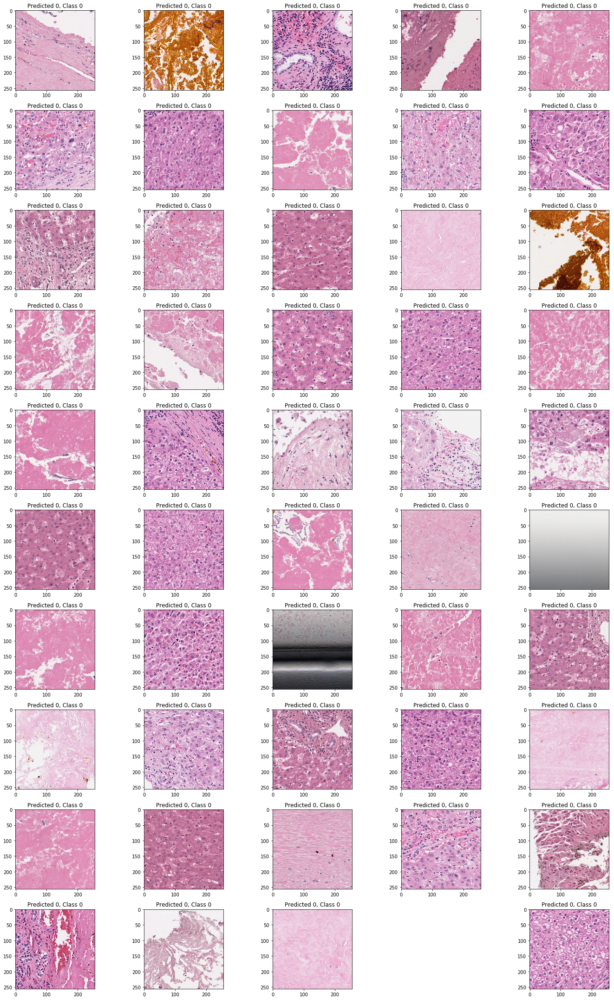

In [40]:
import matplotlib.gridspec as gridspec

correct = np.where(predicted_classes==test_labels)[0]
print("Found %d correct labels" % len(correct))
#f = plt.figure(figsize=(20,20))
plt.figure(figsize = (20,30))
gs1 = gridspec.GridSpec(1, 1)
gs1.update(wspace=0.025, hspace=0.025)
for i, correct in enumerate(correct[:50]):
    plt.subplot(10,5, i+1)
    plt.imshow(test_data[correct].reshape(256,256,3), cmap='gray', interpolation='none')
    plt.title("Predicted {}, Class {}".format(predicted_classes[correct], test_labels[correct]))
    #plt.subplots_adjust(wspace=None, hspace=None)
    plt.tight_layout()

Found 27 incorrect labels
Predicted [1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0], Class [0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1]


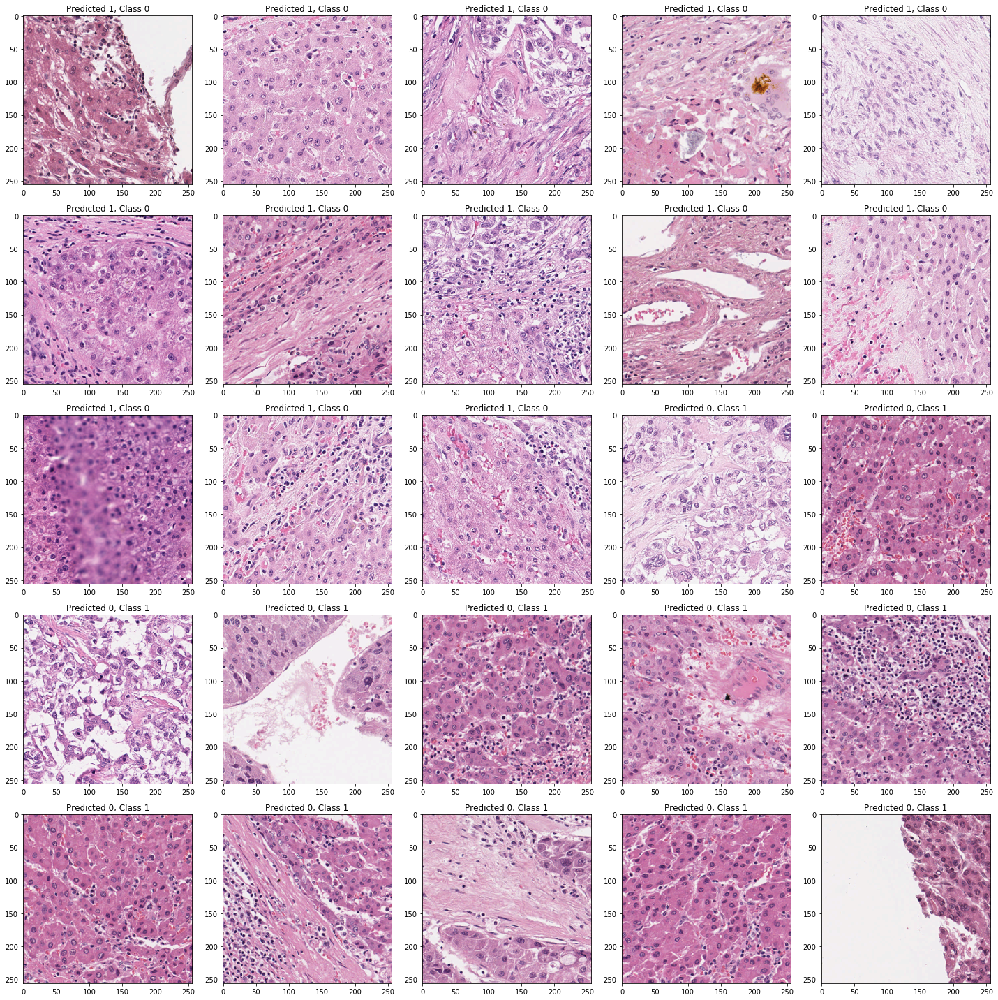

In [41]:
incorrect = np.where(predicted_classes!=test_labels)[0]
print("Found %d incorrect labels" % len(incorrect))
print("Predicted {}, Class {}".format(predicted_classes[incorrect], test_labels[incorrect]))
#f = plt.figure(figsize=(20,20))
plt.figure(figsize = (20,20))
gs1 = gridspec.GridSpec(5, 5)
gs1.update(wspace=0.025, hspace=0.025)
for i, incorrect in enumerate(incorrect[0:25]):
    plt.subplot(5,5,i+1)
    plt.imshow(test_data[incorrect].reshape(256,256,3), cmap='gray', interpolation='none')
    plt.title("Predicted {}, Class {}".format(predicted_classes[incorrect], test_labels[incorrect]))
    plt.tight_layout()

## Classification Report

In [42]:
from sklearn.metrics import classification_report
target_names = ["Class {}".format(i) for i in range(num_classes)]
print(classification_report(test_labels, predicted_classes, target_names=target_names))

              precision    recall  f1-score   support

     Class 0       0.86      0.87      0.87       100
     Class 1       0.87      0.86      0.86       100

    accuracy                           0.86       200
   macro avg       0.87      0.86      0.86       200
weighted avg       0.87      0.86      0.86       200



## Predict Labels (Only 0 class)

In [47]:
test_eval = full_model.evaluate(test_data[:100], test_Y_one_hot[:100], verbose=0)
print('Test loss:', test_eval[0])
print('Test accuracy:', test_eval[1])

Test loss: 0.5789889681339264
Test accuracy: 0.87


In [43]:
predicted_classes = full_model.predict(test_data[:100])
predicted_classes = np.argmax(np.round(predicted_classes),axis=1)

Found 87 correct labels


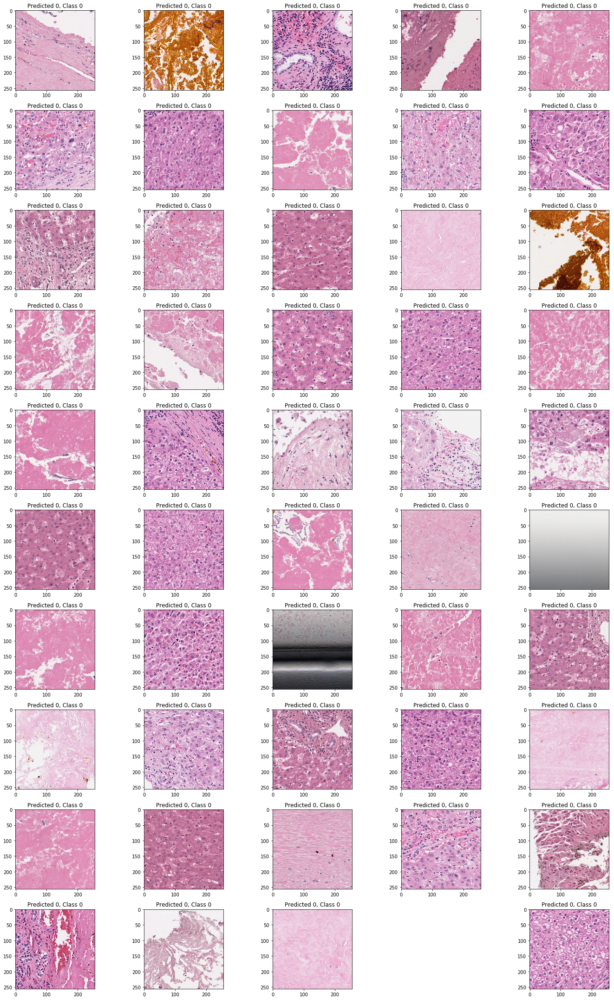

In [44]:
import matplotlib.gridspec as gridspec

correct = np.where(predicted_classes==test_labels[:100])[0]
print("Found %d correct labels" % len(correct))
#f = plt.figure(figsize=(20,20))
plt.figure(figsize = (20,30))
gs1 = gridspec.GridSpec(1, 1)
gs1.update(wspace=0.025, hspace=0.025)
for i, correct in enumerate(correct[:50]):
    plt.subplot(10,5, i+1)
    plt.imshow(test_data[correct].reshape(256,256,3), cmap='gray', interpolation='none')
    plt.title("Predicted {}, Class {}".format(predicted_classes[correct], test_labels[correct]))
    #plt.subplots_adjust(wspace=None, hspace=None)
    plt.tight_layout()

Found 13 incorrect labels
Predicted [1 1 1 1 1 1 1 1 1 1 1 1 1], Class [0 0 0 0 0 0 0 0 0 0 0 0 0]


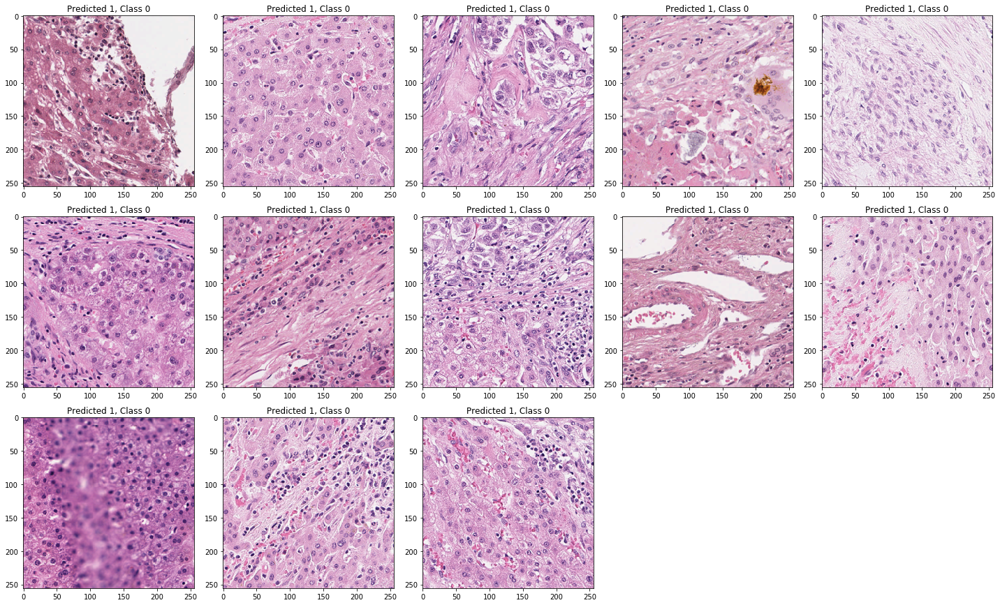

In [45]:
incorrect = np.where(predicted_classes!=test_labels[:100])[0]
print("Found %d incorrect labels" % len(incorrect))
print("Predicted {}, Class {}".format(predicted_classes[incorrect], test_labels[incorrect]))
#f = plt.figure(figsize=(20,20))
plt.figure(figsize = (20,20))
gs1 = gridspec.GridSpec(5, 5)
gs1.update(wspace=0.025, hspace=0.025)
for i, incorrect in enumerate(incorrect[0:25]):
    plt.subplot(5,5,i+1)
    plt.imshow(test_data[incorrect].reshape(256,256,3), cmap='gray', interpolation='none')
    plt.title("Predicted {}, Class {}".format(predicted_classes[incorrect], test_labels[incorrect]))
    plt.tight_layout()

## Predict Labels (Only 1 class)

In [48]:
test_eval = full_model.evaluate(test_data[100:], test_Y_one_hot[100:], verbose=0)
print('Test loss:', test_eval[0])
print('Test accuracy:', test_eval[1])

Test loss: 0.49883333921432493
Test accuracy: 0.86


In [49]:
predicted_classes = full_model.predict(test_data[100:])
predicted_classes = np.argmax(np.round(predicted_classes),axis=1)

Found 86 correct labels


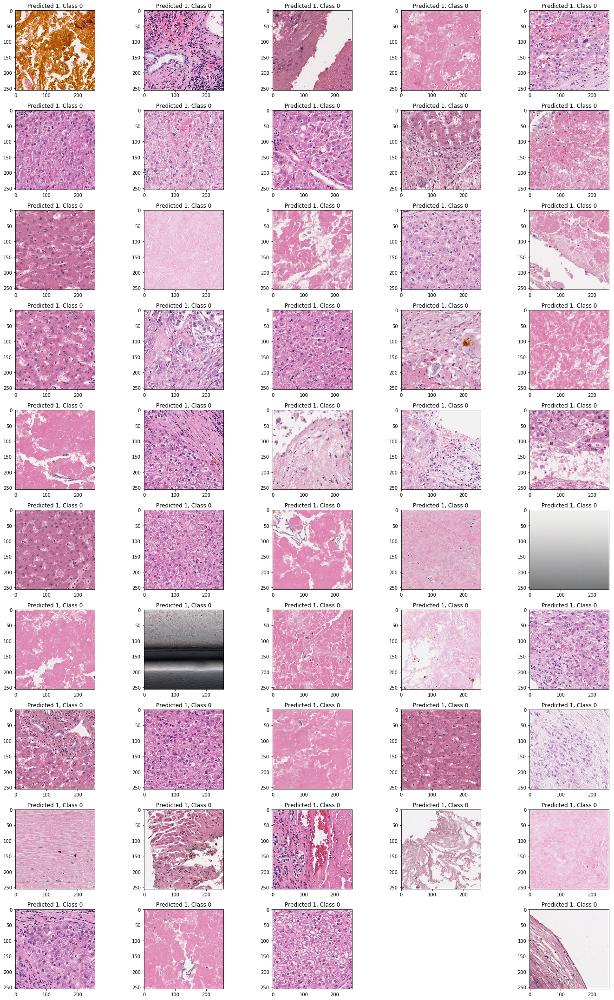

In [50]:
import matplotlib.gridspec as gridspec

correct = np.where(predicted_classes==test_labels[100:])[0]
print("Found %d correct labels" % len(correct))
#f = plt.figure(figsize=(20,20))
plt.figure(figsize = (20,30))
gs1 = gridspec.GridSpec(1, 1)
gs1.update(wspace=0.025, hspace=0.025)
for i, correct in enumerate(correct[:50]):
    plt.subplot(10,5, i+1)
    plt.imshow(test_data[correct].reshape(256,256,3), cmap='gray', interpolation='none')
    plt.title("Predicted {}, Class {}".format(predicted_classes[correct], test_labels[correct]))
    #plt.subplots_adjust(wspace=None, hspace=None)
    plt.tight_layout()

Found 14 incorrect labels
Predicted [0 0 0 0 0 0 0 0 0 0 0 0 0 0], Class [0 0 0 0 0 0 0 0 0 0 0 0 0 0]


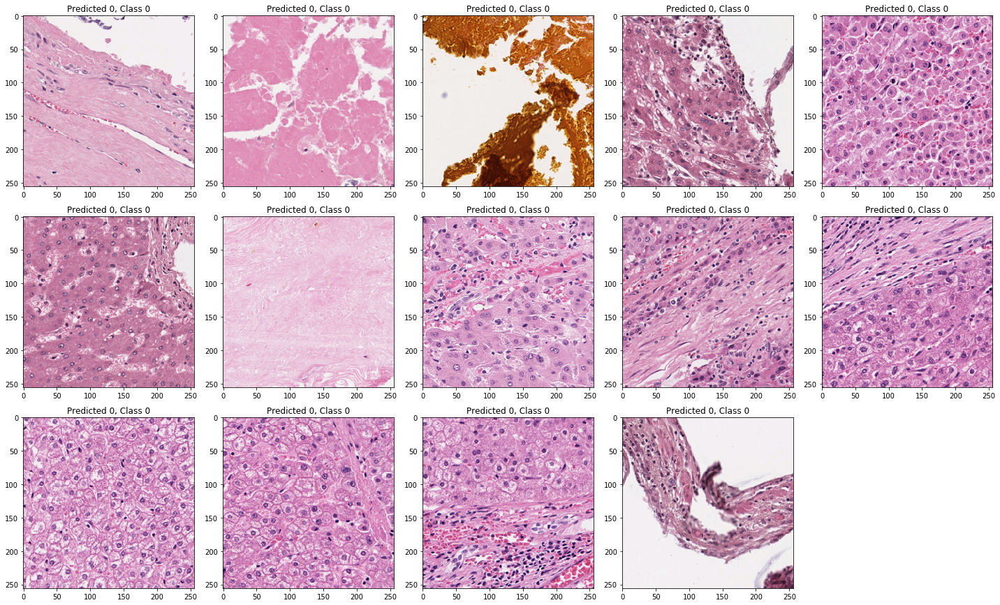

In [51]:
incorrect = np.where(predicted_classes!=test_labels[100:])[0]
print("Found %d incorrect labels" % len(incorrect))
print("Predicted {}, Class {}".format(predicted_classes[incorrect], test_labels[incorrect]))
#f = plt.figure(figsize=(20,20))
plt.figure(figsize = (20,20))
gs1 = gridspec.GridSpec(5, 5)
gs1.update(wspace=0.025, hspace=0.025)
for i, incorrect in enumerate(incorrect[0:25]):
    plt.subplot(5,5,i+1)
    plt.imshow(test_data[incorrect].reshape(256,256,3), cmap='gray', interpolation='none')
    plt.title("Predicted {}, Class {}".format(predicted_classes[incorrect], test_labels[incorrect]))
    plt.tight_layout()

## Classifying with full training (without frozen)

In [30]:
for layer in full_model.layers[0:19]:
    layer.trainable = True
    
full_model.compile(loss=keras.losses.categorical_crossentropy, optimizer=keras.optimizers.Adam(),metrics=['accuracy'])

In [29]:
def on_epoch_end(epoch, logs=None):
    print(K.eval(full_model.optimizer.lr))

## Train the Model

In [31]:
on_epoch_end(epoch=10, logs=None)
classify_train = full_model.fit(train_X, train_label, batch_size=64,epochs=100,verbose=1,callbacks=callbacks_list,validation_data=(valid_X, valid_label))

W0718 19:54:02.238029 140610914539264 deprecation.py:323] From /home/mousumi/ENV_1/lib/python3.6/site-packages/tensorflow/python/ops/math_grad.py:1250: add_dispatch_support.<locals>.wrapper (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


0.001
Train on 1000 samples, validate on 200 samples
Epoch 1/100
1000/1000 [==============================] - 23s 23ms/step - loss: 1.9070 - acc: 0.5910 - val_loss: 1.1181 - val_acc: 0.5950
Epoch 2/100
1000/1000 [==============================] - 10s 10ms/step - loss: 0.9716 - acc: 0.6970 - val_loss: 0.7500 - val_acc: 0.6850
Epoch 3/100
1000/1000 [==============================] - 10s 10ms/step - loss: 0.8534 - acc: 0.7670 - val_loss: 0.6337 - val_acc: 0.7400
Epoch 4/100
1000/1000 [==============================] - 10s 10ms/step - loss: 0.6247 - acc: 0.8140 - val_loss: 0.5662 - val_acc: 0.8000
Epoch 5/100
1000/1000 [==============================] - 10s 10ms/step - loss: 0.5798 - acc: 0.8030 - val_loss: 0.6300 - val_acc: 0.7050
Epoch 6/100
1000/1000 [==============================] - 10s 10ms/step - loss: 0.4945 - acc: 0.8310 - val_loss: 0.5822 - val_acc: 0.7450
Epoch 7/100
1000/1000 [==============================] - 10s 10ms/step - loss: 0.5035 - acc: 0.8400 - val_loss: 0.5685 - val_

In [32]:
full_model.save_weights('classification_complete_100epoch.h5')

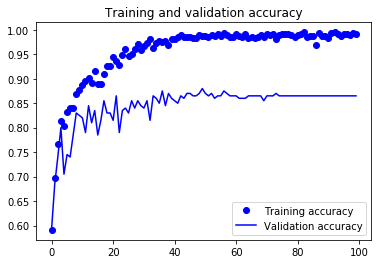

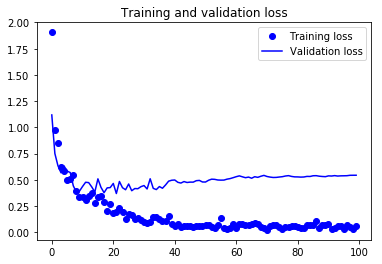

In [33]:
accuracy = classify_train.history['acc']
val_accuracy = classify_train.history['val_acc']
loss = classify_train.history['loss']
val_loss = classify_train.history['val_loss']
epochs = range(len(accuracy))
plt.plot(epochs, accuracy, 'bo', label='Training accuracy')
plt.plot(epochs, val_accuracy, 'b', label='Validation accuracy')
plt.title('Training and validation accuracy')
plt.legend()
plt.figure()
plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
plt.show()

## Model Evaluation on the Test Set

In [34]:
test_eval = full_model.evaluate(test_data, test_Y_one_hot, verbose=0)

In [35]:
print('Test loss:', test_eval[0])
print('Test accuracy:', test_eval[1])

Test loss: 0.2919433641433716
Test accuracy: 0.925


# Predict Labels

In [36]:
predicted_classes = full_model.predict(test_data)

In [37]:
predicted_classes = np.argmax(np.round(predicted_classes),axis=1)

In [38]:
predicted_classes.shape, test_labels.shape

((200,), (200,))

Found 185 correct labels


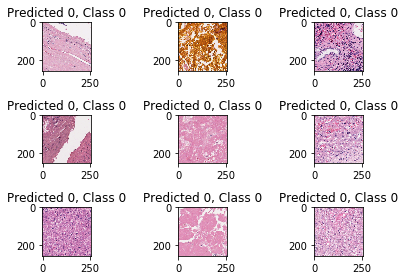

In [39]:
correct = np.where(predicted_classes==test_labels)[0]
print("Found %d correct labels" % len(correct))
for i, correct in enumerate(correct[:9]):
    plt.subplot(3,3,i+1)
    plt.imshow(test_data[correct].reshape(256,256,3), cmap='gray', interpolation='none')
    plt.title("Predicted {}, Class {}".format(predicted_classes[correct], test_labels[correct]))
    plt.tight_layout()

Found 15 incorrect labels


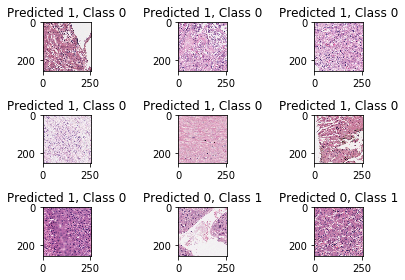

In [40]:
incorrect = np.where(predicted_classes!=test_labels)[0]
print("Found %d incorrect labels" % len(incorrect))
for i, incorrect in enumerate(incorrect[:9]):
    plt.subplot(3,3,i+1)
    plt.imshow(test_data[incorrect].reshape(256,256,3), cmap='gray', interpolation='none')
    plt.title("Predicted {}, Class {}".format(predicted_classes[incorrect], test_labels[incorrect]))
    plt.tight_layout()

## Classification Report

In [41]:
from sklearn.metrics import classification_report
target_names = ["Class {}".format(i) for i in range(num_classes)]
print(classification_report(test_labels, predicted_classes, target_names=target_names))

              precision    recall  f1-score   support

     Class 0       0.92      0.93      0.93       100
     Class 1       0.93      0.92      0.92       100

    accuracy                           0.93       200
   macro avg       0.93      0.93      0.92       200
weighted avg       0.93      0.93      0.92       200



## ResNet evaluation result (For full dataset 60k training images, 12k val, 21k test)

In [10]:
test_labels = np.load('../../ResNet-50-101-152/test_labels.npy')
predicted_classes = np.load('../../ResNet-50-101-152/predicted_classes.npy')
print(test_labels)
print(np.shape(test_labels))
print(predicted_classes)
print(np.shape(predicted_classes))

[0 0 0 ... 1 1 1]
(21019,)
[0 0 0 ... 1 1 1]
(21019,)


Found 19717 correct labels


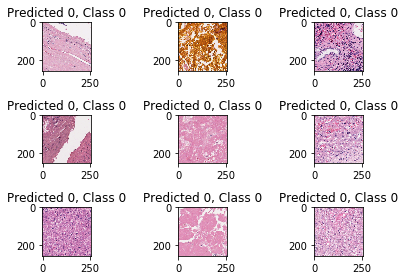

In [11]:
correct = np.where(predicted_classes==test_labels)[0]
print("Found %d correct labels" % len(correct))
for i, correct in enumerate(correct[:9]):
    plt.subplot(3,3,i+1)
    plt.imshow(test_data[correct].reshape(256,256,3), cmap='gray', interpolation='none')
    plt.title("Predicted {}, Class {}".format(predicted_classes[correct], test_labels[correct]))
    plt.tight_layout()

Found 1302 incorrect labels


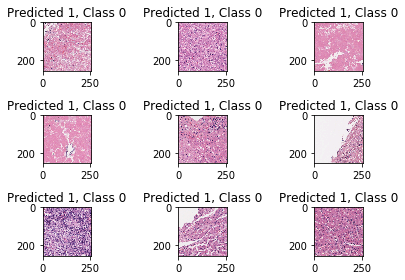

In [12]:
incorrect = np.where(predicted_classes!=test_labels)[0]
print("Found %d incorrect labels" % len(incorrect))
for i, incorrect in enumerate(incorrect[:9]):
    plt.subplot(3,3,i+1)
    plt.imshow(test_data[incorrect].reshape(256,256,3), cmap='gray', interpolation='none')
    plt.title("Predicted {}, Class {}".format(predicted_classes[incorrect], test_labels[incorrect]))
    plt.tight_layout()

## Classification Report

In [15]:
from sklearn.metrics import classification_report
target_names = ["Class {}".format(i) for i in range(num_classes)]
print(classification_report(test_labels, predicted_classes, target_names=target_names))

              precision    recall  f1-score   support

     Class 0       0.96      0.93      0.95     12151
     Class 1       0.91      0.94      0.93      8868

    accuracy                           0.94     21019
   macro avg       0.94      0.94      0.94     21019
weighted avg       0.94      0.94      0.94     21019

